# Sesion 13 - Parte 1 - Analisis EDA Automatizado

In [1]:
import pandas as pd
from ydata_profiling  import ProfileReport

In [2]:
df = pd.read_csv("/workspaces/ER-ml-bootcamp-labs/data/raw/U.S._crude_oil_production.csv")
df

,Month,U.S. Crude Oil,Alabama,Alaska,Arkansas,Arizona,California,Colorado,Federal Offshore Gulf of Mexico Crude Oil,Federal Offshore Pacific Crude Oil,...,Ohio,Oklahoma,Pennsylvania,South Dakota,Wyoming,West Virginia,Virginia,Utah,Texas,Tennessee
0,2008-06-01,5138,21,655,17,0,583,82,1326,67,...,14,186,8,5,144,6,0,60,1097,1
1,2008-07-01,5177,21,640,17,0,586,81,1372,61,...,14,184,8,5,145,5,0,61,1111,1
2,2008-08-01,5003,21,544,17,0,588,82,1272,70,...,14,188,8,5,145,6,0,62,1110,1
3,2008-09-01,3974,21,681,16,0,587,88,242,67,...,14,186,8,5,144,6,0,63,1055,1
4,2008-10-01,4738,21,716,17,0,586,86,803,66,...,14,185,8,5,145,6,0,64,1125,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116,2018-02-01,10248,17,513,14,0,463,428,1704,14,...,54,527,18,4,223,27,0,100,4015,1
117,2018-03-01,10461,17,512,14,0,462,428,1681,16,...,54,543,18,4,231,29,0,104,4185,1
118,2018-04-01,10475,17,497,14,0,465,447,1583,16,...,54,531,19,4,232,29,0,103,4222,1
119,2018-05-01,10443,16,496,14,0,464,447,1504,15,...,58,529,19,3,228,29,0,97,4245,1


In [3]:
profile = ProfileReport(
    df= df,
    title="Reporte EDA rapido",
    explorative=True
)

In [5]:
profile.to_notebook_iframe()

# Sesión 14 - Parte 2 de Modelos de Series de Tiempo

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Librerías de evaluación

from sklearn.metrics import mean_absolute_error, root_mean_squared_error, mean_absolute_percentage_error



In [25]:
df = pd.read_csv("/workspaces/ER-ml-bootcamp-labs/data/raw/U.S._crude_oil_production.csv")

In [7]:
df.head()

,Month,U.S. Crude Oil,Alabama,Alaska,Arkansas,Arizona,California,Colorado,Federal Offshore Gulf of Mexico Crude Oil,Federal Offshore Pacific Crude Oil,...,Ohio,Oklahoma,Pennsylvania,South Dakota,Wyoming,West Virginia,Virginia,Utah,Texas,Tennessee
0,2008-06-01,5138,21,655,17,0,583,82,1326,67,...,14,186,8,5,144,6,0,60,1097,1
1,2008-07-01,5177,21,640,17,0,586,81,1372,61,...,14,184,8,5,145,5,0,61,1111,1
2,2008-08-01,5003,21,544,17,0,588,82,1272,70,...,14,188,8,5,145,6,0,62,1110,1
3,2008-09-01,3974,21,681,16,0,587,88,242,67,...,14,186,8,5,144,6,0,63,1055,1
4,2008-10-01,4738,21,716,17,0,586,86,803,66,...,14,185,8,5,145,6,0,64,1125,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116,2018-02-01,10248,17,513,14,0,463,428,1704,14,...,54,527,18,4,223,27,0,100,4015,1
117,2018-03-01,10461,17,512,14,0,462,428,1681,16,...,54,543,18,4,231,29,0,104,4185,1
118,2018-04-01,10475,17,497,14,0,465,447,1583,16,...,54,531,19,4,232,29,0,103,4222,1
119,2018-05-01,10443,16,496,14,0,464,447,1504,15,...,58,529,19,3,228,29,0,97,4245,1


## ARIMA https://www.statsmodels.org/stable/user-guide.html

In [8]:
# Importación de ARIMA

from statsmodels.tsa.arima.model import ARIMA

In [12]:
# Selección de una columna 

df['Month']

0      2008-06-01
1      2008-07-01
2      2008-08-01
3      2008-09-01
4      2008-10-01
          ...    
116    2018-02-01
117    2018-03-01
118    2018-04-01
119    2018-05-01
120    2018-06-01
Name: Month, Length: 121, dtype: object

In [ ]:
# Nombre del objeto para seleccionar
# 2 o más columnas se usa una lista

df[['Month', 'U.S. Crude Oil ']]

,Month,U.S. Crude Oil
0,2008-06-01,5138
1,2008-07-01,5177
2,2008-08-01,5003
3,2008-09-01,3974
4,2008-10-01,4738
...,...,...
116,2018-02-01,10248
117,2018-03-01,10461
118,2018-04-01,10475
119,2018-05-01,10443


In [23]:
df.columns

Index(['Month', 'U.S. Crude Oil ', 'Alabama', 'Alaska', 'Arkansas', 'Arizona',
       'California', 'Colorado', 'Federal Offshore Gulf of Mexico Crude Oil',
       'Federal Offshore Pacific Crude Oil', 'Florida', 'Idaho', 'Illinois',
       'Indiana', 'Kansas', 'Kentucky', 'Louisiana', 'Michigan', 'Mississippi',
       'Missouri', 'Nebraska', 'Montana', 'Nevada', 'New Mexico', 'New York',
       'North Dakota', 'Ohio', 'Oklahoma', 'Pennsylvania', 'South Dakota',
       'Wyoming', 'West Virginia', 'Virginia', 'Utah', 'Texas', 'Tennessee'],
      dtype='object')

In [37]:
df.rename(columns= {'U.S. Crude Oil ':'Production'}, inplace=True)

In [38]:
df

,Month,Production,Alabama,Alaska,Arkansas,Arizona,California,Colorado,Federal Offshore Gulf of Mexico Crude Oil,Federal Offshore Pacific Crude Oil,...,Ohio,Oklahoma,Pennsylvania,South Dakota,Wyoming,West Virginia,Virginia,Utah,Texas,Tennessee
0,2008-06-01,5138,21,655,17,0,583,82,1326,67,...,14,186,8,5,144,6,0,60,1097,1
1,2008-07-01,5177,21,640,17,0,586,81,1372,61,...,14,184,8,5,145,5,0,61,1111,1
2,2008-08-01,5003,21,544,17,0,588,82,1272,70,...,14,188,8,5,145,6,0,62,1110,1
3,2008-09-01,3974,21,681,16,0,587,88,242,67,...,14,186,8,5,144,6,0,63,1055,1
4,2008-10-01,4738,21,716,17,0,586,86,803,66,...,14,185,8,5,145,6,0,64,1125,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116,2018-02-01,10248,17,513,14,0,463,428,1704,14,...,54,527,18,4,223,27,0,100,4015,1
117,2018-03-01,10461,17,512,14,0,462,428,1681,16,...,54,543,18,4,231,29,0,104,4185,1
118,2018-04-01,10475,17,497,14,0,465,447,1583,16,...,54,531,19,4,232,29,0,103,4222,1
119,2018-05-01,10443,16,496,14,0,464,447,1504,15,...,58,529,19,3,228,29,0,97,4245,1


In [40]:
df1 = df[["Month", "Production"]]
df1

,Month,Production
0,2008-06-01,5138
1,2008-07-01,5177
2,2008-08-01,5003
3,2008-09-01,3974
4,2008-10-01,4738
...,...,...
116,2018-02-01,10248
117,2018-03-01,10461
118,2018-04-01,10475
119,2018-05-01,10443


In [54]:
df1['Month'] = pd.to_datetime(df1.Month, format="%Y-%m-%d")


/tmp/ipykernel_10962/3946463802.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1['Month'] = pd.to_datetime(df1.Month, format="%Y-%m-%d")


In [52]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 121 entries, 0 to 120
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   Month       121 non-null    datetime64[ns]
 1   Production  121 non-null    int64         
dtypes: datetime64[ns](1), int64(1)
memory usage: 2.0 KB


In [ ]:
# Hacer indexing con las fechas
# Necesitaríamos antes hacer un df.sort_values('Month') para organizar
df1 = df1.set_index('Month')

In [56]:
df1

,Production
Month,
2008-06-01,5138
2008-07-01,5177
2008-08-01,5003
2008-09-01,3974
2008-10-01,4738
...,...
2018-02-01,10248
2018-03-01,10461
2018-04-01,10475


In [62]:
help(df1.asfreq)

Help on method asfreq in module pandas.core.generic:

asfreq(freq: 'Frequency', method: 'FillnaOptions | None' = None, how: "Literal['start', 'end'] | None" = None, normalize: 'bool_t' = False, fill_value: 'Hashable | None' = None) -> 'Self' method of pandas.core.frame.DataFrame instance
    Convert time series to specified frequency.

    Returns the original data conformed to a new index with the specified
    frequency.

    If the index of this Series/DataFrame is a :class:`~pandas.PeriodIndex`, the new index
    is the result of transforming the original index with
    :meth:`PeriodIndex.asfreq <pandas.PeriodIndex.asfreq>` (so the original index
    will map one-to-one to the new index).

    Otherwise, the new index will be equivalent to ``pd.date_range(start, end,
    freq=freq)`` where ``start`` and ``end`` are, respectively, the first and
    last entries in the original index (see :func:`pandas.date_range`). The
    values corresponding to any timesteps in the new index which

In [57]:
df1 = df1.asfreq('MS')

In [58]:
# Parámetros para primer modelo
#(p,d,q)
order= (1,1,1) # Ventana móvil 
horizon = 12   # Ventana de tiempo para validaciones

In [59]:
# Selección por omisión
train = df1[:-horizon] # Dame todos los valores, menos los últimos definidos en horizon
test = df1[-horizon:] # Dame todos los valores después del horizon

In [60]:
train

,Production
Month,
2008-06-01,5138
2008-07-01,5177
2008-08-01,5003
2008-09-01,3974
2008-10-01,4738
...,...
2017-02-01,9083
2017-03-01,9140
2017-04-01,9085


In [61]:
test

,Production
Month,
2017-07-01,9230
2017-08-01,9244
2017-09-01,9495
2017-10-01,9703
2017-11-01,10103
2017-12-01,10040
2018-01-01,9995
2018-02-01,10248
2018-03-01,10461


In [ ]:
# Generación de modelo

model = ARIMA(train, order= order)
result = model.fit()

In [65]:
pred = result.forecast(steps= horizon)

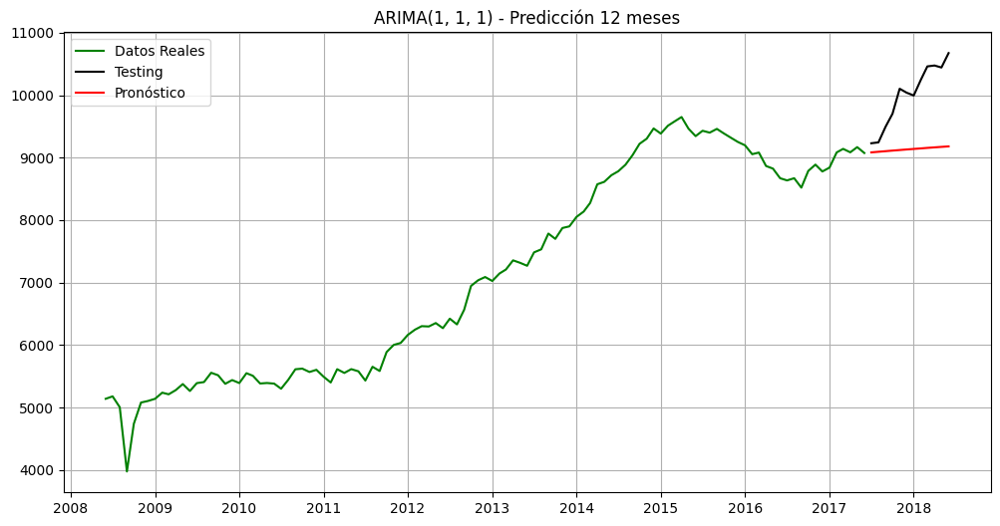

In [71]:
# Crear el lienzo
plt.figure(figsize=(12,6))

# Agregar datos reales
plt.plot(train, label="Datos Reales", color= "green")

# Agregar datos de prueba
plt.plot(test,label="Testing", color= "black")

# Agregar línea 
plt.plot(pred.index,pred, label= "Pronóstico", color= "red")

#Agregar título
plt.title(f'ARIMA{order} - Predicción {horizon} meses')

# Agregar leyenda
plt.legend()

# Agregar cuadrícula
plt.grid()

# Generar imagen
plt.show()

## Seasonal ARIMA

In [74]:
from statsmodels.tsa.stattools import adfuller, acf, pacf
from statsmodels.tsa.statespace.sarimax import SARIMAX

In [ ]:
# Prueba de estacionalidad

adfuller_test = adfuller(df1)

(np.float64(0.2627139289047078),
 np.float64(0.9755676444885656),
 0,
 120,
 {'1%': np.float64(-3.486055829282407),
  '5%': np.float64(-2.8859430324074076),
  '10%': np.float64(-2.5797850694444446)},
 np.float64(1345.610183056119))

In [4]:
# Valor estadístico o Valor de adfuller
adfuller_test[0]

NameError: name 'adfuller_test' is not defined

In [2]:
# p-value
adfuller_test[1]

NameError: name 'adfuller_test' is not defined